In [2]:
from astropy.io import fits
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
np.seterr(divide='ignore', invalid='ignore');
plt.rcParams.update({'figure.max_open_warning': 0})
import scipy.stats as stats
import astropy.units as u
from astropy.table import Table, Column, MaskedColumn, join
from tqdm import tqdm
from bisect import bisect_left
c = 2.998e10
k = 1.38e-16
h = 6.626e-27
plt.rcParams.update({'font.size': 22})
halpha = 6564.61
hbeta = 4862.68
hgamma = 4341.68
hdelta = 4102.89
plt.rcParams['figure.figsize'] = [15, 10]
from IPython.display import Audio, display
def allDone():
    display(Audio(filename='beep.mp3', autoplay=True))
from scipy.interpolate import interp1d,InterpolatedUnivariateSpline
import lmfit

def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx
import emcee
import corner
import numdifftools
from scipy.ndimage import interpolation
from scipy.signal import medfilt
from scipy.interpolate import interp1d
from multiprocessing import Pool
import pickle

In [3]:
import numpy as np
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import normalize,scale,MinMaxScaler,StandardScaler
import multiprocessing

Using TensorFlow backend.


# Get Data Spectra

In [4]:
wdtable = Table.read('wdtable_sn.fits')

good = (
    (wdtable['subclass'] == 'WD')[:,0].data
)

print(len(wdtable[good]))
plt.scatter(wdtable['bp_rp'],wdtable['abs_g'],s = 5, alpha=0.1,color='k')
plt.scatter(wdtable[good]['bp_rp'],wdtable[good]['abs_g'],s = 5, alpha=0.7,color='r')
plt.gca().invert_yaxis()
wdtable = wdtable[good]

FileNotFoundError: [Errno 2] No such file or directory: 'wdtable_sn.fits'

In [1]:
bgrid = np.linspace(np.min(wdtable['bp_rp']),np.max(wdtable['bp_rp']),10)
ggrid = np.linspace(np.min(wdtable['abs_g']),np.max(wdtable['abs_g']),10)
bint = bgrid[1]-bgrid[0]
gint = ggrid[1]-ggrid[0]

NameError: name 'np' is not defined

In [5]:
selections = [];
for i in tqdm(bgrid):
    for j in ggrid:
        square = (wdtable['bp_rp'] > i)*(wdtable['abs_g'] > j)*\
                (wdtable['bp_rp'] < i+bint)*(wdtable['abs_g'] < j+gint)
        if len(wdtable[square]) > 0:
            snidxs = np.argsort(wdtable[square]['S2N'])
            snmaxidxs = snidxs[0:5]
            selections.append(wdtable[square][snmaxidx]['specnames'])

100%|██████████| 50/50 [01:11<00:00,  1.07it/s]


In [6]:
idxs = [];
for i in selections:
    idxs.append(np.argmax(wdtable['specnames'] == i))

In [7]:
goodtable = wdtable[idxs]
len(goodtable)

713

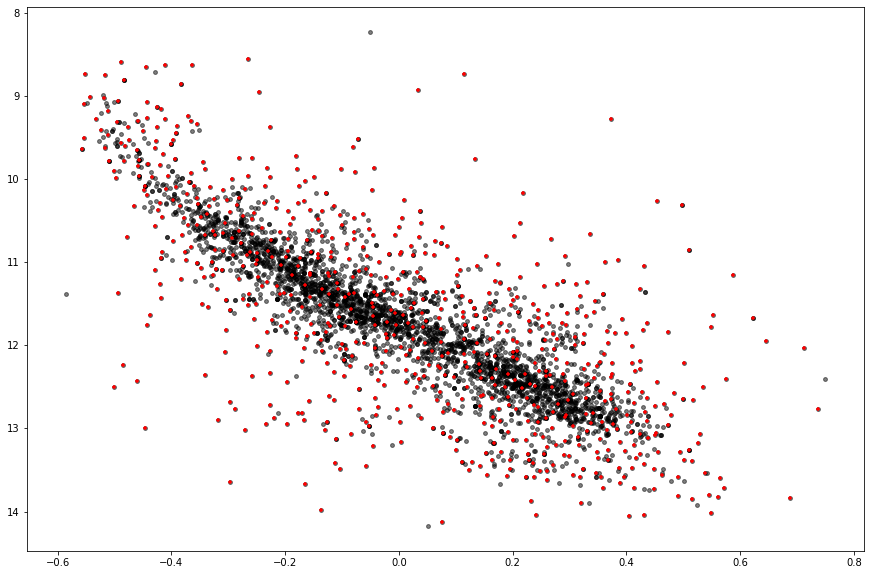

In [8]:
plt.figure(figsize=(15,10))
plt.scatter(wdtable['bp_rp'],wdtable['abs_g'],s=15,color='k',alpha=0.5)
plt.scatter(goodtable['bp_rp'],goodtable['abs_g'],s=15,color='r',marker='+')
plt.gca().invert_yaxis()

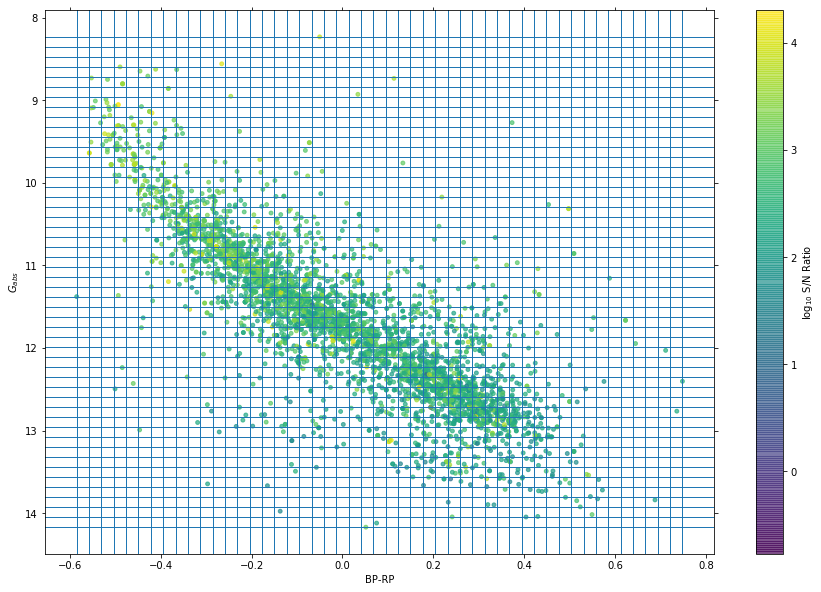

In [9]:
plt.rcParams['xtick.top'] = True
plt.rcParams['ytick.right'] = True

plt.figure(figsize=(15,10))

for i in range(len(bgrid)):
    plt.axvline(bgrid[i],linewidth=1)
    plt.axhline(ggrid[i],linewidth=1)

plt.scatter(wdtable['bp_rp'],wdtable['abs_g'],s=15,alpha=0.7,c=wdtable['S2N'])
cbar = plt.colorbar()

cbar.ax.set_ylabel('$\log_{10}$ S/N Ratio')
plt.gca().invert_yaxis()
plt.xlabel('BP-RP')
plt.ylabel('$G_{abs}$')
plt.rcParams.update({'font.size': 22})


In [10]:
bigtable = wdtable
wdtable = goodtable
TeffHs = [];
loggHs = [];
specnames = []
spectra = [];

# def rvcorr(spectrum):
#     lamgrid = np.arange(4000,8000)
#     coremask = (lamgrid == 6565)+(lamgrid == 4863)+(lamgrid == 4342)+(lamgrid == 4103)
#     coremask = coremask.astype(int)
#     trans = np.argmax(np.correlate(1-spectrum,coremask,mode='full'))-4000
#     if trans > 5:
#         trans = 5;
#     elif trans < 5:
#         trans = -5;
#     else:
#         ;
#     shiftedspec = interpolation.shift(spectrum,-trans,cval=1)
#     return shiftedspec

searchparameter = list(wdtable['specnames'])
bprps = [];
gs = [];
## Enter search parameter, if needed:
inputPath = "../scratch/spec_old/"

if os.path.exists(inputPath+".DS_Store"):
    os.remove(inputPath+"/.DS_Store")
    
filenames = [i+'.fits' for i in searchparameter]

from scipy.signal import medfilt
from scipy.interpolate import interp1d

len(filenames)

for specname in tqdm(filenames):
    f = fits.open(inputPath+specname)
    loglam = f[1].data['loglam']
    flux = f[1].data['flux']
    lam = 10**loglam
    lam = lam.astype(np.float64)
    flux = flux.astype(np.float64)
    lamgrid = np.arange(4000,8000)
    func = interp1d(lam,flux,kind='cubic',assume_sorted = False,fill_value='extrapolate')
    flux = func(lamgrid)
    spectra.append(flux)
    TeffHs.append(wdtable[wdtable['specnames']==specname[:-5]]['TeffH'][0])
    loggHs.append(wdtable[wdtable['specnames']==specname[:-5]]['loggH'][0])
    bprps.append(wdtable[wdtable['specnames']==specname[:-5]]['bp_rp'][0])
    gs.append(wdtable[wdtable['specnames']==specname[:-5]]['abs_g'][0])
    specnames.append(specname)
spectra = np.asarray(spectra)
TeffHs = np.asarray(TeffHs)
loggHs = np.asarray(loggHs)
bprps = np.asarray(bprps)
gs = np.asarray(gs)

100%|██████████| 713/713 [02:43<00:00,  4.61it/s]


In [11]:
lam = np.arange(4000,8000)
lamgrid = lam
lines = ((lam > hbeta-300) & (lam < hbeta + 300)) | ((lam > halpha-400) & (lam < halpha + 400))\
        | ((lam > hgamma-400) & (lam < hgamma + 200))

mask = ~lines | ((lam > 4010) & (lam < 4050)) | ((lam > 4190) & (lam < 4230))
def quadratic(array,c1,c2,c3,c4):
    return c1 + c2*array + c3*array**2 + c4*array**3

In [12]:
normspec = [];

for i in tqdm(range(len(spectra))):
    p,cov = curve_fit(quadratic,lamgrid[mask],spectra[i][mask],p0=[-25,1e-2,1e-5,1e-10])
    contcorr = (spectra[i]/quadratic(lam,p[0],p[1],p[2],p[3]))
    skylinemask = (lamgrid > 5578.5 - 10)*(lamgrid < 5578.5 + 10) + (lamgrid > 5894.6 - 10)*(lamgrid < 5894.6 + 10)\
        + (lamgrid > 6301.7 - 10)*(lamgrid < 6301.7 + 10) + (lamgrid > 7246.0 - 10)*(lamgrid < 7246.0 + 10) + \
        (lamgrid > 5173 - 10)*(lamgrid < 5173 + 10)
    contcorr[skylinemask] = 1
    #contcorr = rvcorr(contcorr)
    #contcorr = np.log(contcorr)
    where = np.isnan(contcorr)
    contcorr[where] = 0
    normspec.append(contcorr[0:3000])
normspec = np.asarray(normspec)
len(normspec)

100%|██████████| 713/713 [00:01<00:00, 385.23it/s]


713

2.4817714575461522


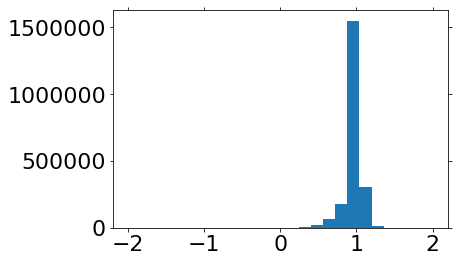

In [13]:
print(np.max(normspec))
plt.hist(np.ravel(normspec),bins=25,range = (-2,2));

In [14]:
where = (normspec > 2.5)+(normspec < -1)

In [15]:
normspec[where] = 1

2.4817714575461522


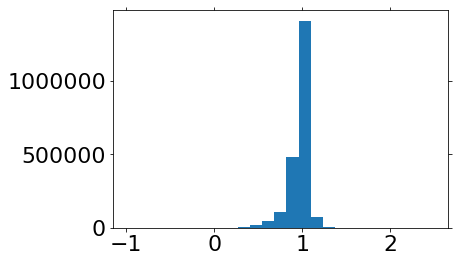

In [16]:
plt.hist(np.ravel(normspec),bins=25);
print(np.max(normspec))

# Train Generator

In [17]:
sc = StandardScaler()
msc = StandardScaler()

In [18]:
X = sc.fit_transform(np.stack((bprps,gs)).transpose())
t = msc.fit_transform(normspec)

In [19]:
#import keras
def generator():
    x = Input(shape=X[0].shape)
    y = Dense(25,activation='sigmoid')(x)
    y = Dropout(0.5)(y)
    y = Dense(25,activation='sigmoid')(y)
    y = Dropout(0.5)(y)
    out = Dense(t[0].shape[0],activation = 'linear')(y)
    
    model = Model(inputs = x, outputs = out)
    model.compile(optimizer = Adam(lr=0.001), loss = 'mse', \
                  metrics = ['mean_absolute_percentage_error'])
    return model
model = generator()
print(model.summary())
model.load_weights('ddriven_outliers.h5')

W0809 15:55:38.586479 46940708599104 deprecation_wrapper.py:119] From /home-4/vchandr8@jhu.edu/anaconda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0809 15:55:38.601148 46940708599104 deprecation_wrapper.py:119] From /home-4/vchandr8@jhu.edu/anaconda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0809 15:55:38.603397 46940708599104 deprecation_wrapper.py:119] From /home-4/vchandr8@jhu.edu/anaconda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0809 15:55:38.613253 46940708599104 deprecation_wrapper.py:119] From /home-4/vchandr8@jhu.edu/anaconda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:133: The name tf.placeholder_with_default is depre

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 2)                 0         
_________________________________________________________________
dense_1 (Dense)              (None, 25)                75        
_________________________________________________________________
dropout_1 (Dropout)          (None, 25)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 25)                650       
_________________________________________________________________
dropout_2 (Dropout)          (None, 25)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 3000)              78000     
Total params: 78,725
Trainable params: 78,725
Non-trainable params: 0
_________________________________________________________________
None


In [22]:
epoch = 10000
batch = len(X)
history = [];
for i in tqdm(range(epoch)):
    h = model.fit(X,t,epochs=1,verbose=0,batch_size=batch)
    history.append(h.history['loss'][0])

100%|██████████| 10000/10000 [03:29<00:00, 47.80it/s]


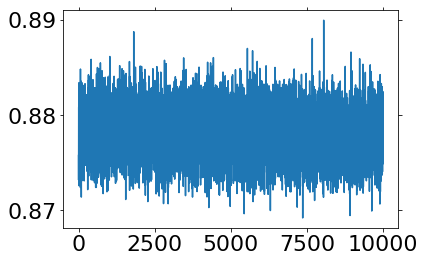

In [23]:
plt.plot((history))

### Evaluate BPRP Sensitivity

Text(0.5, 1.0, 'H-Beta Line')

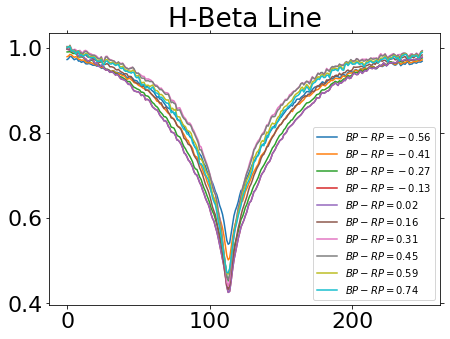

In [20]:
plt.figure(figsize=(7,5))
ts = np.linspace(min(bprps),max(bprps),10)
ls = np.linspace(np.mean(gs),np.mean(gs),10)
samples = sc.transform(np.stack((ts,ls)).transpose())
gens = msc.inverse_transform(model.predict(samples))
tscores = (ts - np.min(ts))/(np.max(ts) - np.min(ts))
for i in range(len(gens)):
    plt.plot(gens[i][750:1000],label='$BP-RP = %.2f$'%ts[i])
plt.legend(fontsize=10)
plt.title('H-Beta Line')

### Evaluate G_abs Sensitivity

Text(0.5, 1.0, 'H-Beta Line')

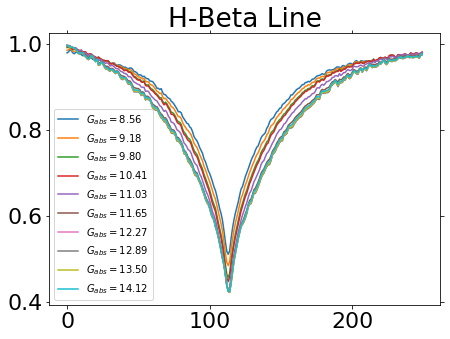

In [21]:
plt.figure(figsize=(7,5))
ts = np.linspace(np.mean(bprps),np.mean(bprps),10)
ls = np.linspace(min(gs),max(gs),10)
samples = sc.transform(np.stack((ts,ls)).transpose())
gens = msc.inverse_transform(model.predict(samples))
for i in range(len(gens)):
    plt.plot(gens[i][750:1000],label='$G_{abs} = %.2f$'%ls[i])

plt.legend(fontsize=10)
plt.title('H-Beta Line')

In [22]:
bigtable = Table.read('wdtable.fits')
searchparameter = list(bigtable['specnames'])

## Enter search parameter, if needed:
inputPath = "../scratch/spec_old/"

if os.path.exists(inputPath+".DS_Store"):
    os.remove(inputPath+"/.DS_Store")
    
filenames = [i+'.fits' for i in searchparameter]

from scipy.signal import medfilt
from scipy.interpolate import interp1d

len(filenames)


allspectra = [];
allspecnames = [];
for specname in tqdm(filenames):
    f = fits.open(inputPath+specname)
    loglam = f[1].data['loglam']
    flux = f[1].data['flux']
    lam = 10**loglam
    lam = lam.astype(np.float64)
    flux = flux.astype(np.float64)
    lamgrid = np.arange(4000,8000)
    func = interp1d(lam,flux,kind='cubic',assume_sorted = False,fill_value='extrapolate')
    flux = func(lamgrid)
    allspectra.append(flux)
    allspecnames.append(specname)
allspectra = np.asarray(allspectra)
allspecnames = np.asarray(allspecnames)

100%|██████████| 11075/11075 [27:30<00:00,  6.04it/s] 


In [23]:
lam = np.arange(4000,8000)
lamgrid = lam
lines = ((lam > hbeta-300) & (lam < hbeta + 300)) | ((lam > halpha-400) & (lam < halpha + 400))\
        | ((lam > hgamma-400) & (lam < hgamma + 200))

mask = ~lines | ((lam > 4010) & (lam < 4050)) | ((lam > 4190) & (lam < 4230))
def quadratic(array,c1,c2,c3,c4):
    return c1 + c2*array + c3*array**2 + c4*array**3

In [24]:
allnormspec = [];

for i in tqdm(range(len(allspectra))):
    p,cov = curve_fit(quadratic,lamgrid[mask],allspectra[i][mask],p0=[-25,1e-2,1e-5,1e-10])
    contcorr = (allspectra[i]/quadratic(lam,p[0],p[1],p[2],p[3]))
    skylinemask = (lamgrid > 5578.5 - 10)*(lamgrid < 5578.5 + 10) + (lamgrid > 5894.6 - 10)*(lamgrid < 5894.6 + 10)\
        + (lamgrid > 6301.7 - 10)*(lamgrid < 6301.7 + 10) + (lamgrid > 7246.0 - 10)*(lamgrid < 7246.0 + 10) + \
        (lamgrid > 5173 - 10)*(lamgrid < 5173 + 10)
    contcorr[skylinemask] = 1
    #contcorr = rvcorr(contcorr)
    #contcorr = np.log(contcorr)
    where = np.isnan(contcorr)
    contcorr[where] = 0
    allnormspec.append(contcorr[0:3000])
allnormspec = np.asarray(allnormspec)
len(allnormspec)

100%|██████████| 11075/11075 [00:30<00:00, 359.82it/s]


11075

In [28]:
bprps = np.asarray(bigtable['bp_rp'])
gs = np.asarray(bigtable['abs_g'])
specnames = np.asarray(bigtable['specnames']).astype(str)

In [29]:
labels = sc.transform(np.stack((bprps,gs)).transpose())

In [30]:
predictions = msc.inverse_transform(model.predict(labels))

In [31]:
residuals = allnormspec - predictions

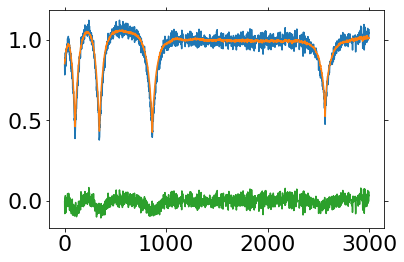

In [33]:
i = np.random.randint(len(allnormspec))
plt.plot(allnormspec[i])
plt.plot(predictions[i])
plt.plot(residuals[i])

### Filter Residuals

In [57]:
where = (residuals < -1)+(residuals > 1)
residuals[where] = 0

In [64]:
sel1 = 2400
sel2 = 2700

In [65]:
r2s = [];
for i in tqdm(range(len(residuals))):
    r2 = stats.probplot(residuals[i][sel1:sel2])[1][2]
    r2s.append(r2)
r2s = np.asarray(r2s)

100%|██████████| 11075/11075 [00:04<00:00, 2468.85it/s]


(array([2.0000e+00, 0.0000e+00, 1.0000e+00, 0.0000e+00, 1.1000e+01,
        1.5000e+01, 2.7000e+01, 7.8000e+01, 5.2900e+02, 1.0412e+04]),
 array([0.40844952, 0.46755178, 0.52665404, 0.5857563 , 0.64485856,
        0.70396083, 0.76306309, 0.82216535, 0.88126761, 0.94036987,
        0.99947213]),
 <a list of 10 Patch objects>)

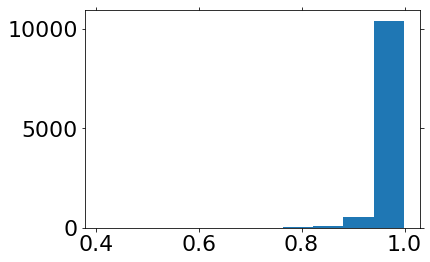

In [66]:
plt.hist(r2s)

In [67]:
n_outliers = 250

In [68]:
outlieridx = (r2s).argsort()[:n_outliers]

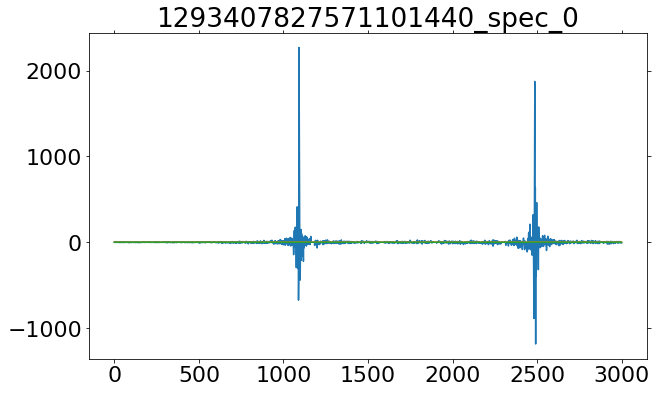

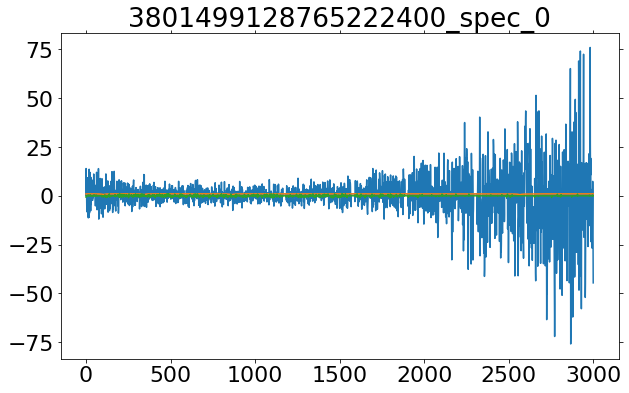

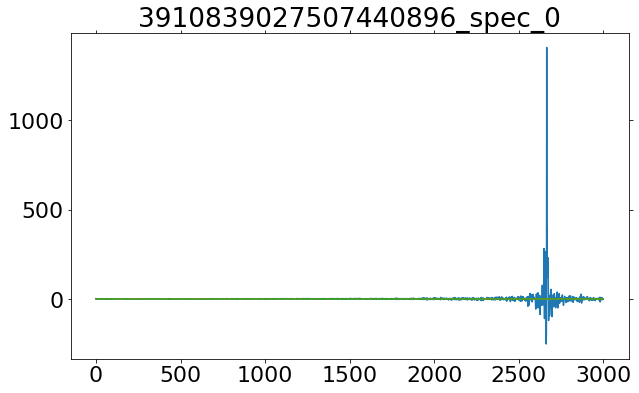

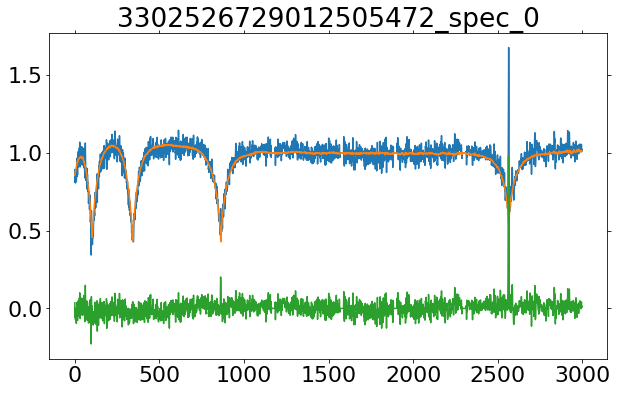

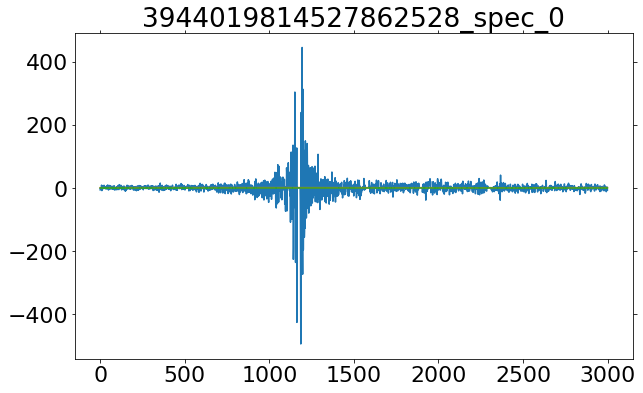

...

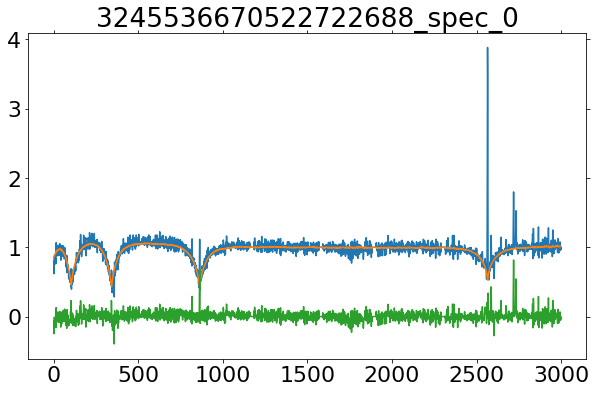

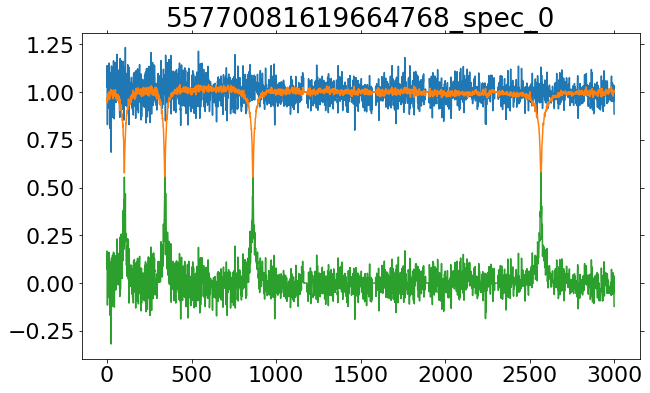

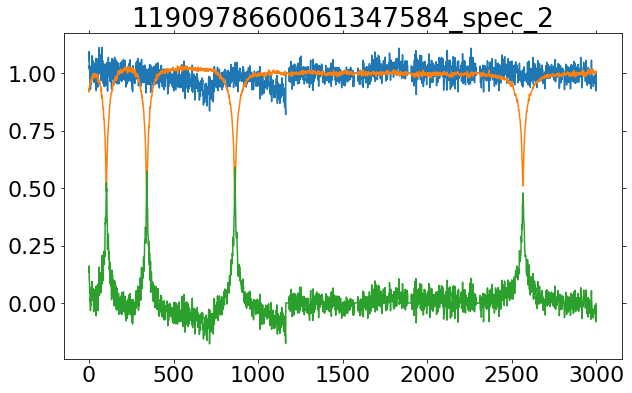

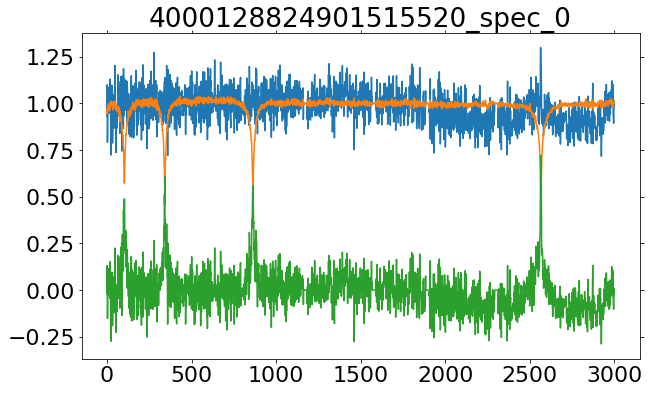

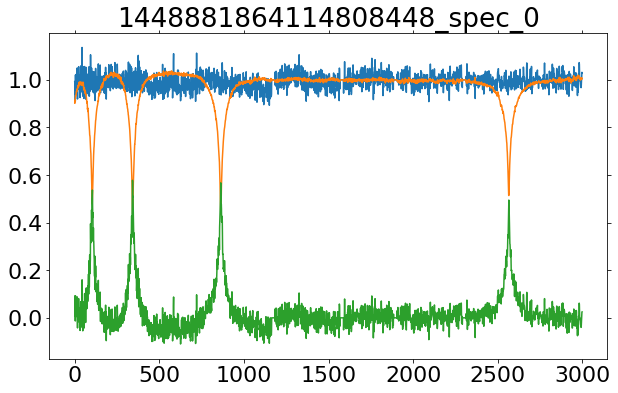

In [69]:
for i in outlieridx:
    plt.figure(figsize=(10,6))
    plt.plot(allnormspec[i])
    plt.plot(predictions[i])
    plt.plot(residuals[i])
    plt.title(specnames[i])
    plt.show()

# HBETA AUTOCORR

In [92]:
betaresids = residuals[:,750:1000]

In [94]:
import numpy
def return_synthetic_data(X):
    """
    The function returns a matrix with the same dimensions as X but with synthetic data
    based on the marginal distributions of its featues
    """
    features = len(X[0])
    X_syn = numpy.zeros(X.shape)

    for i in range(features):
        obs_vec = X[:,i]
        syn_vec = numpy.random.choice(obs_vec, len(obs_vec)) # here we chose the synthetic data to match the marginal distribution of the real data
        X_syn[:,i] = X_syn[:,i] + syn_vec

    return X_syn
betaresids_syn = return_synthetic_data(betaresids)

In [95]:
def merge_work_and_synthetic_samples(X, X_syn):
    """
    The function merges the data into one sample, giving the label "1" to the real data and label "2" to the synthetic data
    """
    # build the labels vector
    Y = numpy.ones(len(X))
    Y_syn = numpy.ones(len(X_syn)) * 2

    Y_total = numpy.concatenate((Y, Y_syn))
    X_total = numpy.concatenate((X, X_syn))
    return X_total, Y_total

X_total, Y_total = merge_work_and_synthetic_samples(betaresids, betaresids_syn)

In [97]:
from sklearn.ensemble import RandomForestClassifier
N_TRAIN = 25 # number of trees in the forest
rand_f = RandomForestClassifier(n_estimators=N_TRAIN)
rand_f.fit(X_total, Y_total)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=25,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
def build_similarity_matrix(rand_f, X):
    """
    The function builds the similarity matrix based on the feature matrix X for the results Y
    based on the random forest we've trained
    the matrix is normalised so that the biggest similarity is 1 and the lowest is 0

    This function counts only leaves in which the object is classified as a "real" object 
    it is also implemented to optimize running time, asumming one has enough running memory
    """
    # apply to get the leaf indices
    apply_mat = rand_f.apply(X)
    # find the predictions of the sample
    is_good_matrix = numpy.zeros(apply_mat.shape)
    for i, est in enumerate(rand_f.estimators_):
        d = est.predict_proba(X)[:, 0] == 1
        is_good_matrix[:, i] = d
    # mark leaves that make the wrong prediction as -1, in order to remove them from the distance measurement
    apply_mat[is_good_matrix == False] = -1 
    # now calculate the similarity matrix
    sim_mat = numpy.sum((apply_mat[:, None] == apply_mat[None, :]) & (apply_mat[:, None] != -1) & (apply_mat[None, :] != -1), axis=2) / numpy.asfarray(numpy.sum([apply_mat != -1], axis=2), dtype='float')
    return sim_mat

sim_mat = build_similarity_matrix(rand_f, betaresids)
dis_mat = 1 - sim_mat

### Shapiro-Wilk Test

In [40]:
shaps = [];

for i in range(len(residuals)):
    shaps.append(stats.shapiro(residuals[i])[0])
    
shaps = np.asarray(shaps)

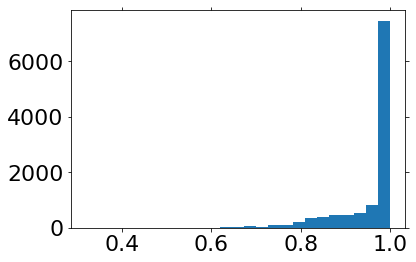

In [41]:
plt.hist(shaps,bins=25);

In [45]:
n_outliers = 250

outlieridx = (shaps).argsort()[:n_outliers]

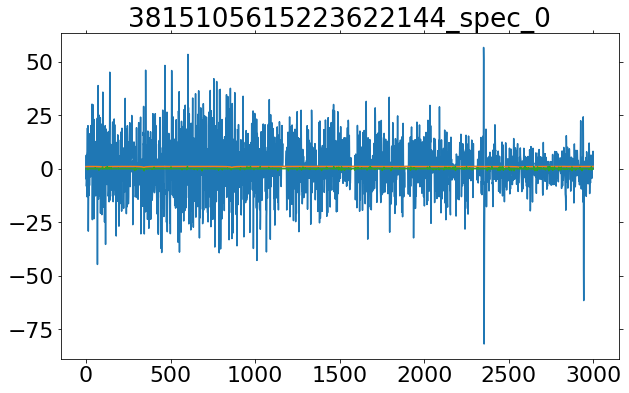

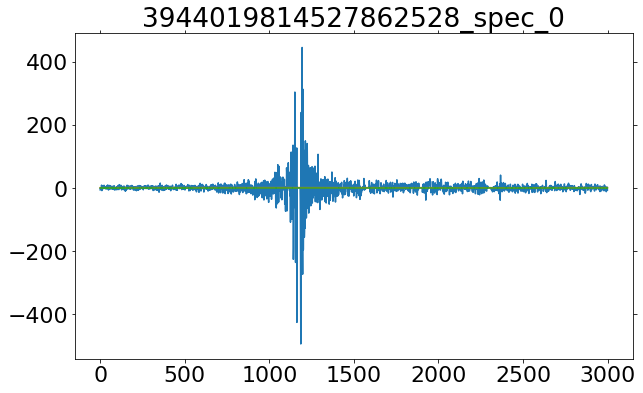

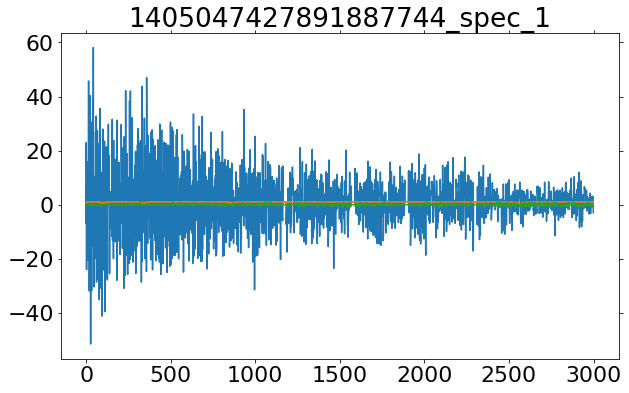

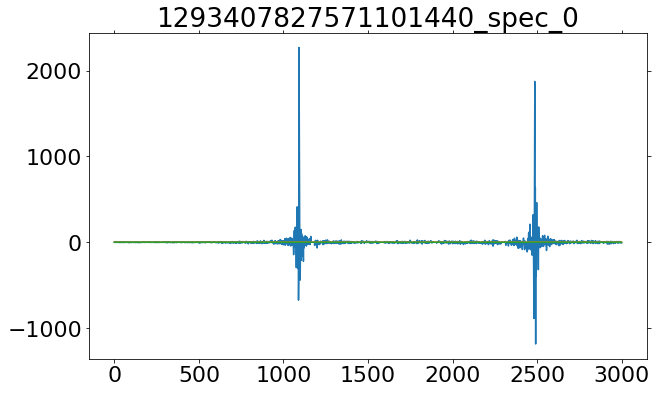

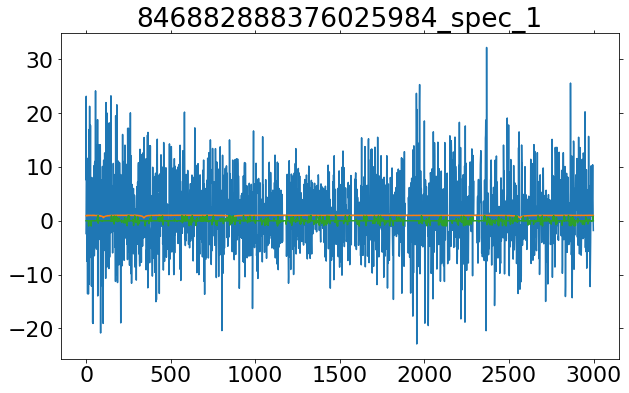

...

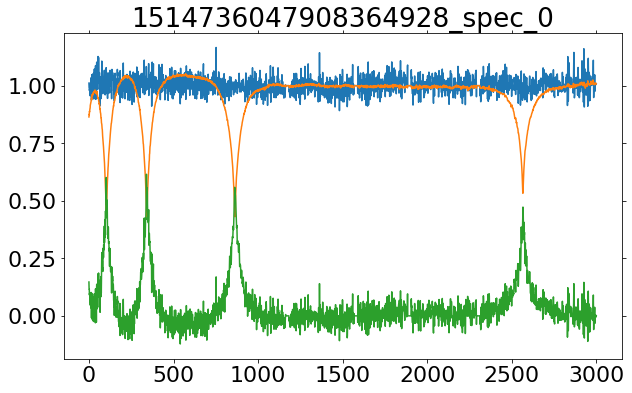

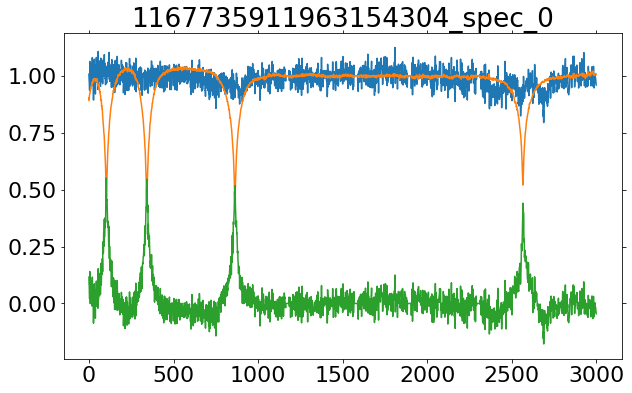

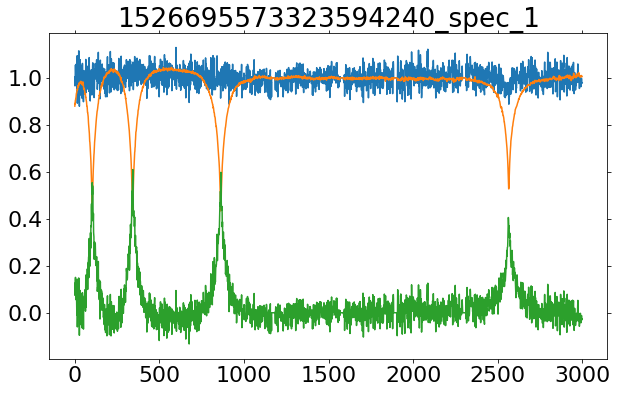

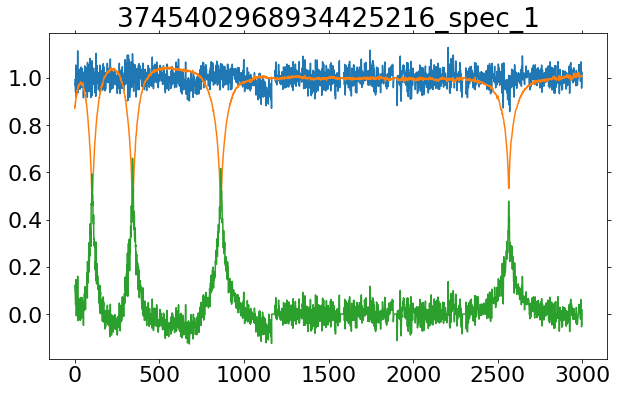

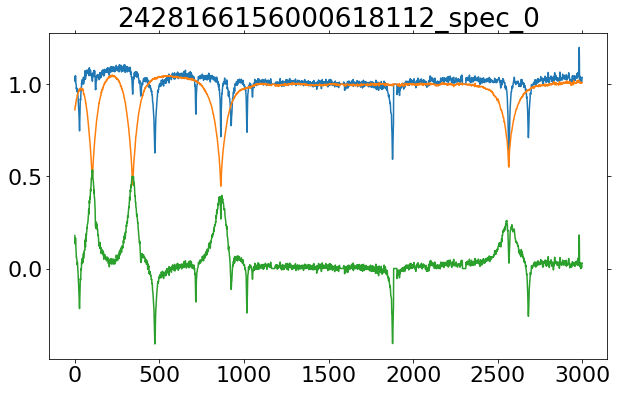

In [54]:
for i in outlieridx:
    plt.figure(figsize=(10,6))
    plt.plot(allnormspec[i])
    plt.plot(predictions[i])
    plt.plot(residuals[i])
    plt.title(specnames[i])
    plt.show()

## Fitter

In [101]:
filename = ['4487216358658978560_spec_0.fits']

In [76]:

spectra = []
TeffHs = []
loggHs = []
specnames = []
for specname in tqdm(filename):
    f = fits.open(inputPath+specname)
    loglam = f[1].data['loglam']
    flux = f[1].data['flux']
    lam = 10**loglam
    lam = lam.astype(np.float64)
    flux = flux.astype(np.float64)
    lamgrid = np.arange(4000,8000)
    func = interp1d(lam,flux,kind='cubic',assume_sorted = False,fill_value='extrapolate')
    flux = func(lamgrid)
    spectra.append(flux)
    specnames.append(specname)
spectra = np.asarray(spectra)
TeffHs = np.asarray(TeffHs)
loggHs = np.asarray(loggHs)
bprps = np.asarray(bprps)
gs = np.asarray(gs)

lam = np.arange(4000,8000)
lamgrid = lam
lines = ((lam > hbeta-300) & (lam < hbeta + 300)) | ((lam > halpha-400) & (lam < halpha + 400))\
        | ((lam > hgamma-400) & (lam < hgamma + 200))

mask = ~lines | ((lam > 4010) & (lam < 4050)) | ((lam > 4190) & (lam < 4230))
def quadratic(array,c1,c2,c3,c4):
    return c1 + c2*array + c3*array**2 + c4*array**3

normspec = [];

for i in tqdm(range(len(spectra))):
    p,cov = curve_fit(quadratic,lamgrid[mask],spectra[i][mask],p0=[-25,1e-2,1e-5,1e-10])
    contcorr = (spectra[i]/quadratic(lam,p[0],p[1],p[2],p[3]))
    skylinemask = (lamgrid > 5578.5 - 10)*(lamgrid < 5578.5 + 10) + (lamgrid > 5894.6 - 10)*(lamgrid < 5894.6 + 10)\
        + (lamgrid > 6301.7 - 10)*(lamgrid < 6301.7 + 10) + (lamgrid > 7246.0 - 10)*(lamgrid < 7246.0 + 10)
    contcorr[skylinemask] = 1
    #contcorr = rvcorr(contcorr)
    #contcorr = np.log(contcorr)
    where = np.isnan(contcorr)
    contcorr[where] = 0
    normspec.append(contcorr[0:3000])
normspec = np.asarray(normspec)
len(normspec)

100%|██████████| 1/1 [00:00<00:00, 316.62it/s]


1






  0%|          | 0/1 [00:00<?, ?it/s]

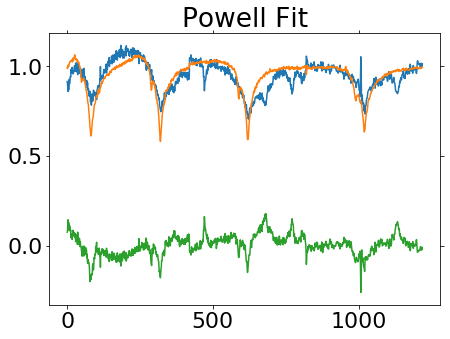

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 220
    # data points      = 1220
    # variables        = 3
    chi-square         = 3.91403212
    reduced chi-square = 0.00321613
    Akaike info crit   = -6999.28644
    Bayesian info crit = -6983.96662
[[Variables]]
    bprp:   0.66555304 +/- 0.25288212 (38.00%) (init = 0)
    absg:   14.1209329 +/- 0.02299075 (0.16%) (init = 10)
    trans: -31.3796607 +/- 0.40222709 (1.28%) (init = 0)

 Starting Bayesian Sampling................
...Done.


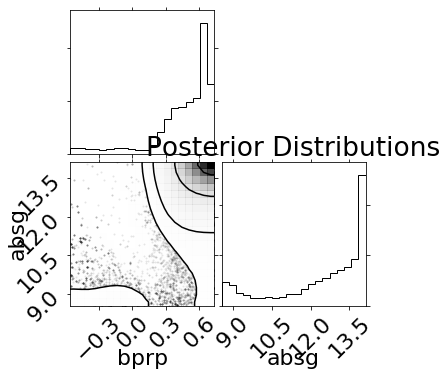

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 25000
    # data points      = 1220
    # variables        = 2
    chi-square         = 3.93310060
    reduced chi-square = 0.00322915
    Akaike info crit   = -6995.35724
    Bayesian info crit = -6985.14403
[[Variables]]
    bprp:   0.53418290 +/- 0.19909320 (37.27%) (init = 0.665553)
    absg:   13.0073908 +/- 1.95126954 (15.00%) (init = 14.12093)
    trans: -31.37966 (fixed)
[[Correlations]] (unreported correlations are < 0.100)
    C(bprp, absg) =  0.583


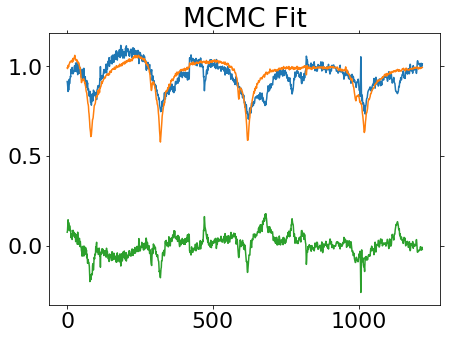






100%|██████████| 1/1 [00:35<00:00, 35.15s/it]

In [98]:
modelscaling = 1
from astropy.convolution import Gaussian1DKernel
from scipy.signal import convolve as scipy_convolve
def spectrum_sampler(wl,bprp,absg,trans):
    label = sc.transform(np.asarray(np.stack((bprp,absg)).reshape(1,-1)))
    synth = (interpolation.shift(model.predict(label)[0],trans,cval=np.nan)*modelscaling)
    newsynth = scipy_convolve(synth,Gaussian1DKernel(5),'same')
    return msc.inverse_transform(synth)[lines].astype('float32')

def chisquare(residual):
    return sum(residual**2)

lamgrid = np.arange(4000,7000)
fitter = lmfit.Model(spectrum_sampler)
params = fitter.make_params(bprp = 0.,absg=10.,trans=0.)
lam = lamgrid
lines = lines = ((lam > hbeta-200) & (lam < hbeta + 200)) | ((lam > halpha-200) & (lam < halpha + 200))\
        | ((lam > hgamma-320) & (lam < hgamma + 100))

params['bprp'].set(min=np.min(bprps),max=np.max(bprps))
params['absg'].set(min=np.min(gs),max=np.max(gs))

bayesparams = fitter.make_params(bprp = 0.,absg=10.,trans=0.)
bayesparams['bprp'].set(min=np.min(bprps),max=np.max(bprps))
bayesparams['absg'].set(min=np.min(gs),max=np.max(gs))

fitoutput = np.zeros((len(normspec),5))
bayesoutput = np.zeros((len(normspec),5))
for i in tqdm(range(len(normspec))):
    spec = normspec[i][lines]
    fitoutput[i,0] = int(specnames[i][:-12])
    bayesoutput[i,0] = int(specnames[i][:-12])
    result = fitter.fit(spec*modelscaling,params,wl=lamgrid[lines],method="powell",nan_policy='omit',calc_covar=True,
                       fit_kws={'reduce_fcn':chisquare})
    
    fitoutput[i,1] = result.params['bprp'].value
    fitoutput[i,2] = result.params['bprp'].stderr
    fitoutput[i,3] = result.params['absg'].value
    fitoutput[i,4] = result.params['absg'].stderr
    
    plt.figure(figsize=(7,5))
    plt.plot(spec*modelscaling)
    plt.plot(spectrum_sampler(None,result.params['bprp'],result.params['absg'],result.params['trans']))
    plt.plot(result.residual)
    plt.title('Powell Fit')
    plt.show()
    print(lmfit.fit_report(result))
    
    # BAYESIAN FITTING ##
    
    bayesparams['bprp'].set(value = result.params['bprp'].value)
    bayesparams['absg'].set(value = result.params['absg'].value)
    print('\n Starting Bayesian Sampling................')
    bayesparams['trans'].set(value = result.params['trans'].value,vary=False)
    bayesresult = fitter.fit(spec*modelscaling,bayesparams,wl=lamgrid[lines],method="emcee",nan_policy='omit',\
                             calc_covar=True, fit_kws={'nwalkers':100,'steps':250})
    print('...Done.')
    f = corner.corner(bayesresult.flatchain[['bprp','absg']],smooth=2)
    plt.title('Posterior Distributions')
    plt.show()
    print(lmfit.fit_report(bayesresult))
    plt.figure(figsize=(7,5))
    plt.plot(spec*modelscaling)
    plt.plot(spectrum_sampler(None,bayesresult.params['bprp'],bayesresult.params['absg'],bayesresult.params['trans']))
    plt.plot(result.residual)
    plt.title('MCMC Fit')
    plt.show()
    bayesoutput[i,1] = bayesresult.params['bprp'].value
    bayesoutput[i,2] = bayesresult.params['bprp'].stderr
    bayesoutput[i,3] = bayesresult.params['absg'].value
    bayesoutput[i,4] = bayesresult.params['absg'].stderr

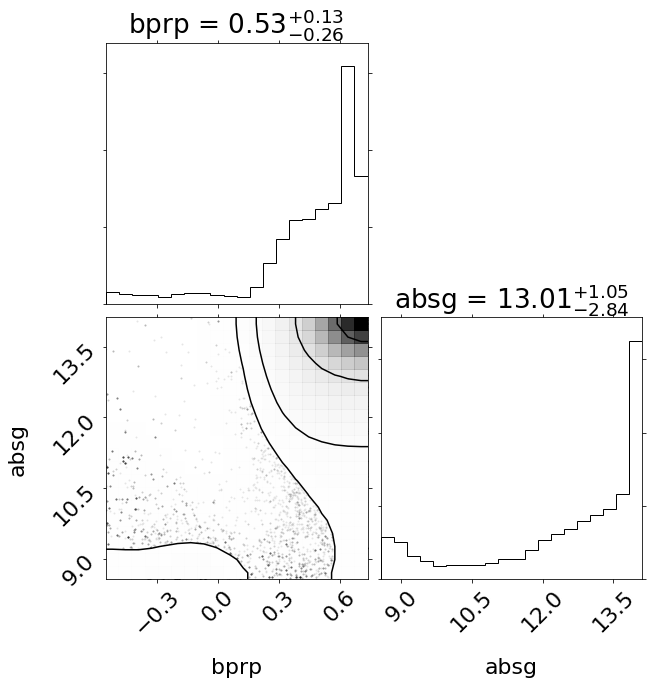

In [103]:
fig,axs = plt.subplots(2,2,figsize=(10,10))
f = corner.corner(bayesresult.flatchain[['bprp','absg']],smooth=2,fig=fig,show_titles = True)
plt.show()

### Evaluate Residuals of Random Control Spectra

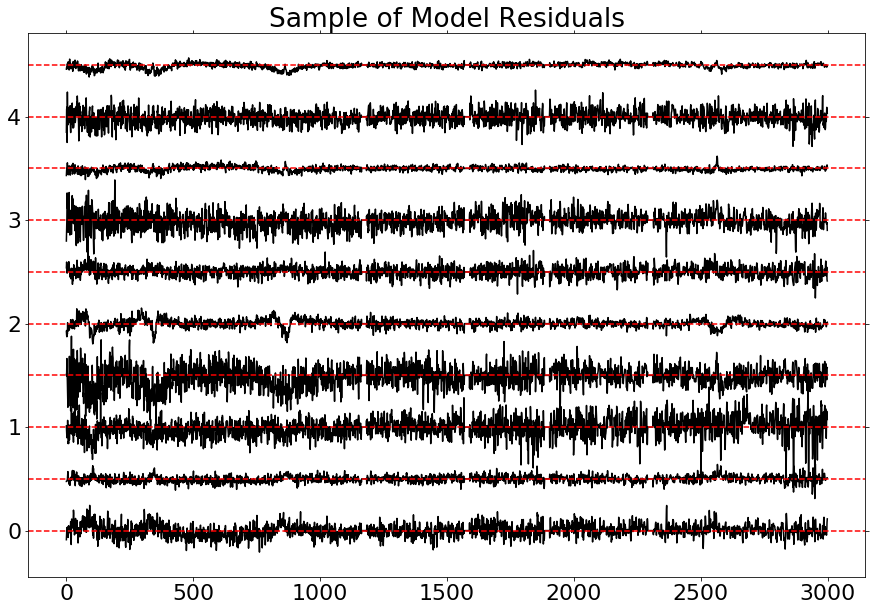

In [104]:
resids = msc.inverse_transform(model.predict(X))- msc.inverse_transform(t) 
plt.figure(figsize=(15,10))
ct=0
for i in np.random.randint(0,len(resids),10):
    plt.plot(resids[i] + 0.5*ct,'k')
    plt.axhline(0.5*ct,color='r',linestyle='--')
    ct += 1
    plt.title('Sample of Model Residuals')

In [207]:
preds = msc.inverse_transform(model.predict(X))
reals = msc.inverse_transform(t)
labels = sc.inverse_transform(X)

Text(0.5, 1.0, 'BP-RP = ')

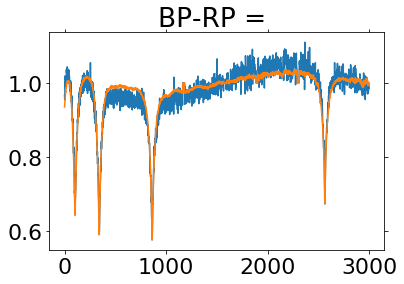

In [208]:
i = 35

label = labels[i]
plt.plot(reals[i])
plt.plot(preds[i])
plt.title('BP-RP = ')

## Autocorr Method

In [260]:
resids = msc.inverse_transform(model.predict(X)) - msc.inverse_transform(t)

In [261]:
autos = [];
corrtimes = [];
for i in range(len(resids)):
    autocorr = np.correlate(resids[i],resids[i],mode='full')
    autocorr = autocorr/max(autocorr)
    corrtime = sum(autocorr)
    autos.append(autocorr)
    corrtimes.append(corrtime)

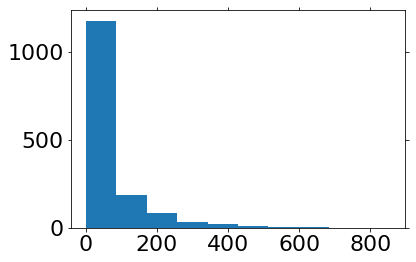

In [262]:
plt.hist(corrtimes,bins=10);

In [270]:
outliers = np.asarray(corrtimes) > 600
outspec = normspec[outliers]
outpred = msc.inverse_transform(model.predict(X)[outliers])
outlabel = sc.inverse_transform(X[outliers])
outresids = resids[outliers]
outautos = np.asarray(autos)[outliers]
len(X[outliers])

4

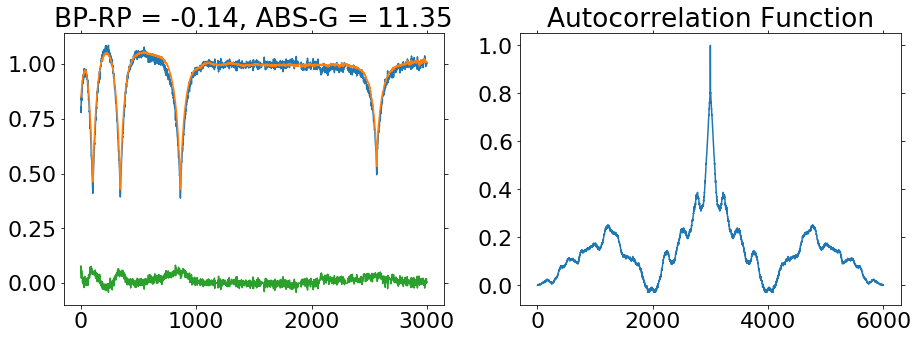

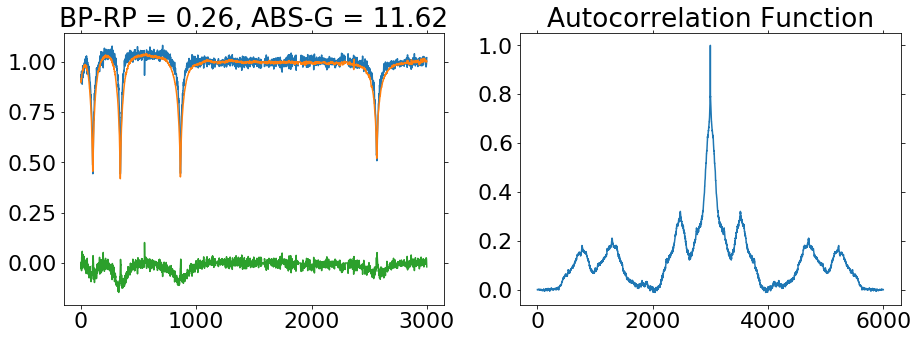

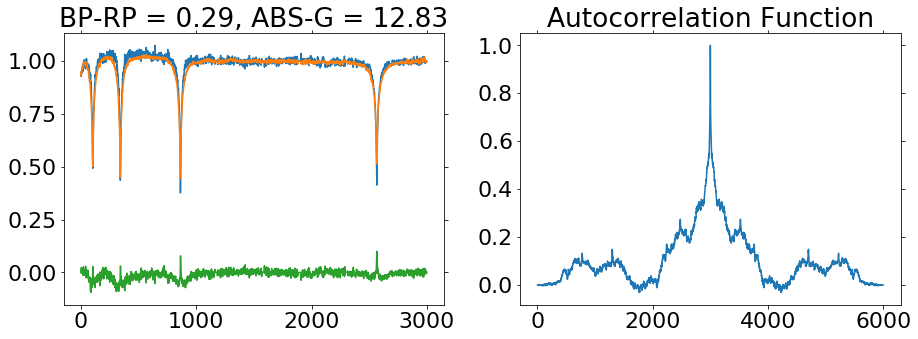

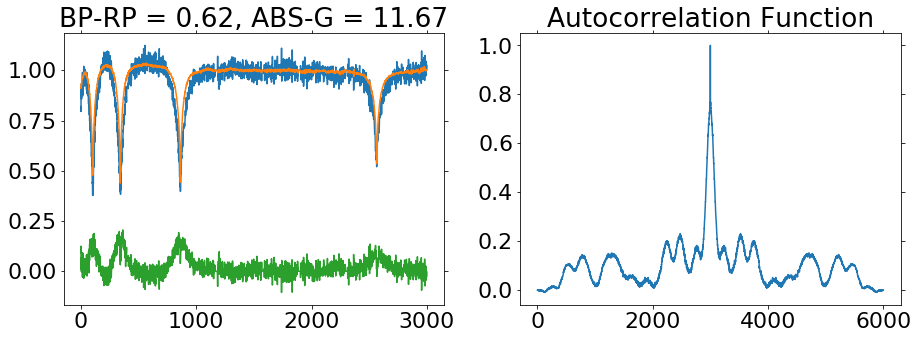

In [271]:
for i in range(sum(outliers)):
    plt.figure(figsize=(15,5))
    plt.subplot(121)
    plt.plot(outspec[i],label='Data')
    plt.title('BP-RP = %.2f, ABS-G = %0.2f'%(outlabel[i][0],outlabel[i][1]))
    plt.plot(outpred[i],label='Prediction')
    plt.plot(outresids[i])
    plt.subplot(122)
    plt.title('Autocorrelation Function')
    plt.plot(outautos[i])
    plt.show()

# Shapiro Test

In [67]:
shaps = [];
for i in range(len(resids)):
    shaps.append(stats.shapiro(resids[i])[0])

In [68]:
shaps = np.asarray(shaps)

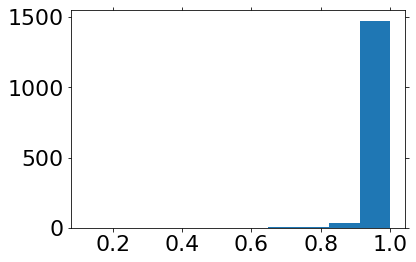

In [69]:
plt.hist(shaps);

In [72]:
outliers = shaps < 0.85

outspec = normspec[outliers]
outpred = msc.inverse_transform(model.predict(X)[outliers])
outlabel = sc.inverse_transform(X[outliers])
outnames = np.asarray(specnames)[outliers]

1434748982169485568_spec_1.fits


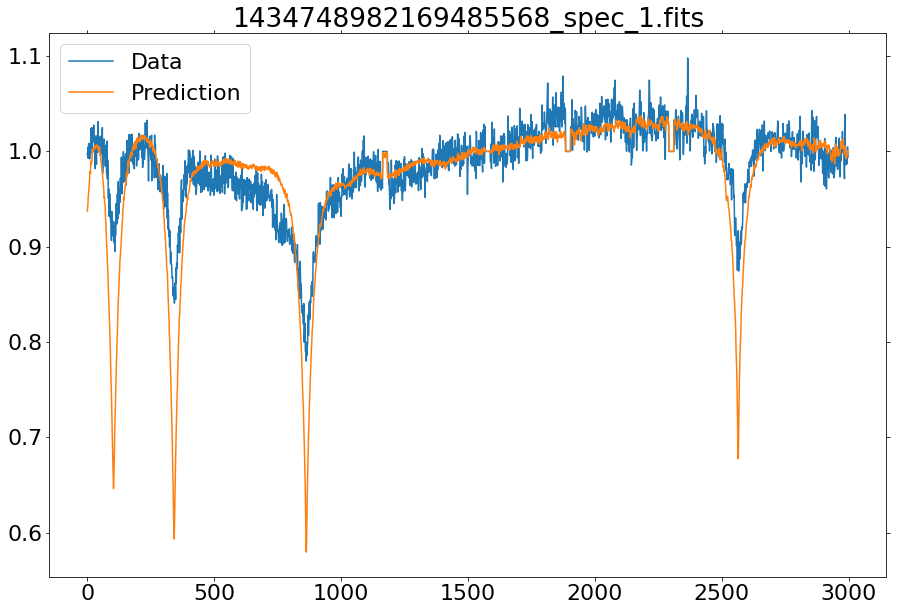

3302538209462061696_spec_0.fits


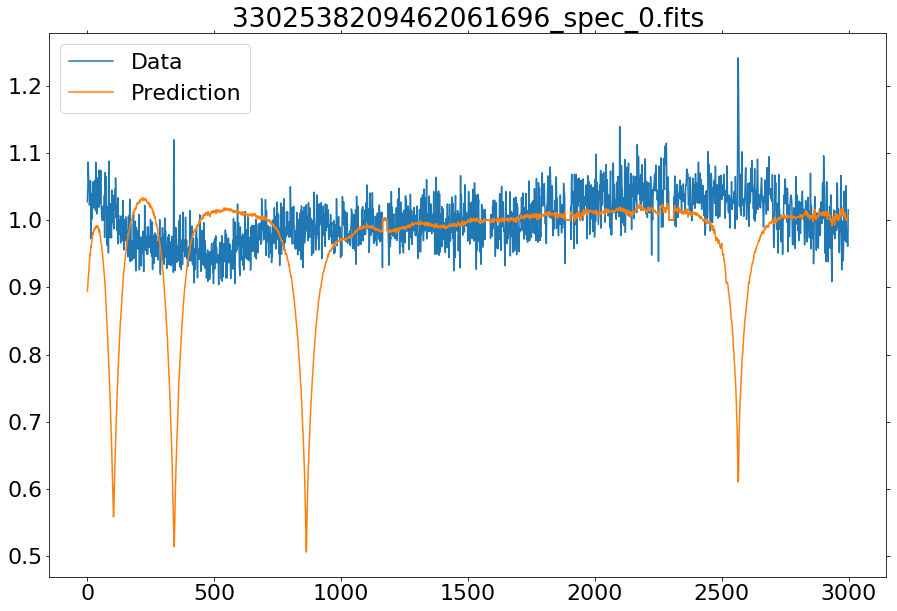

4417843183603168640_spec_2.fits


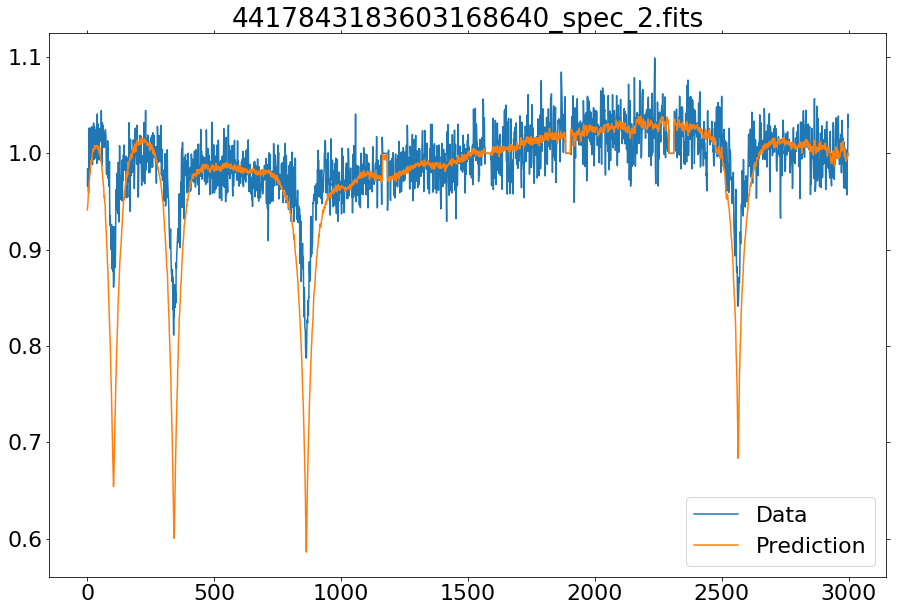

1195463537927048320_spec_0.fits


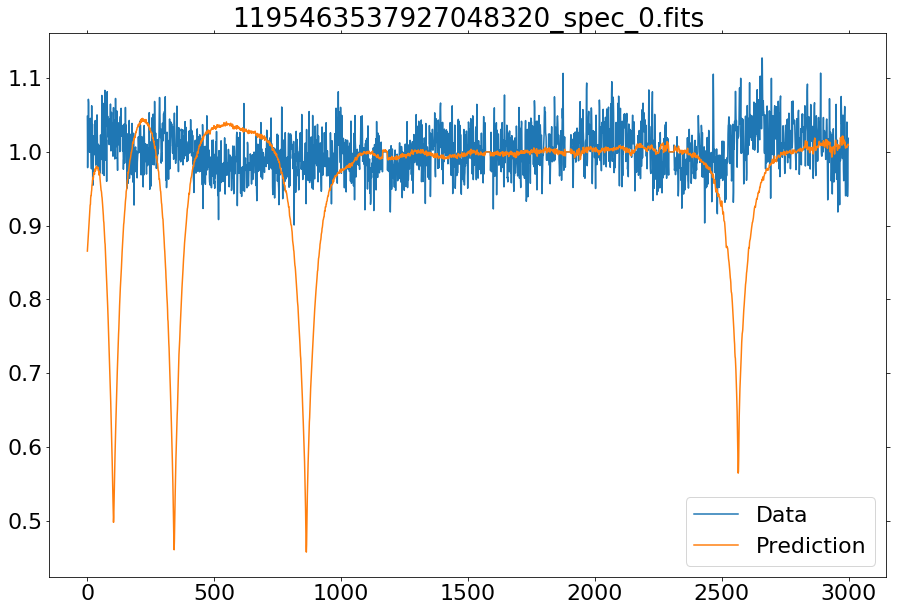

700346923589710080_spec_0.fits


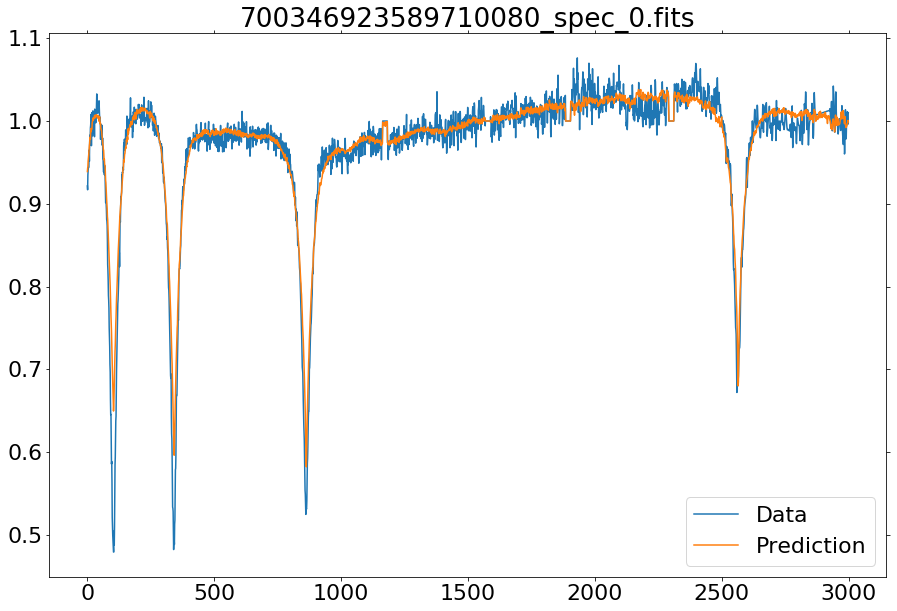

4487216358658978560_spec_0.fits


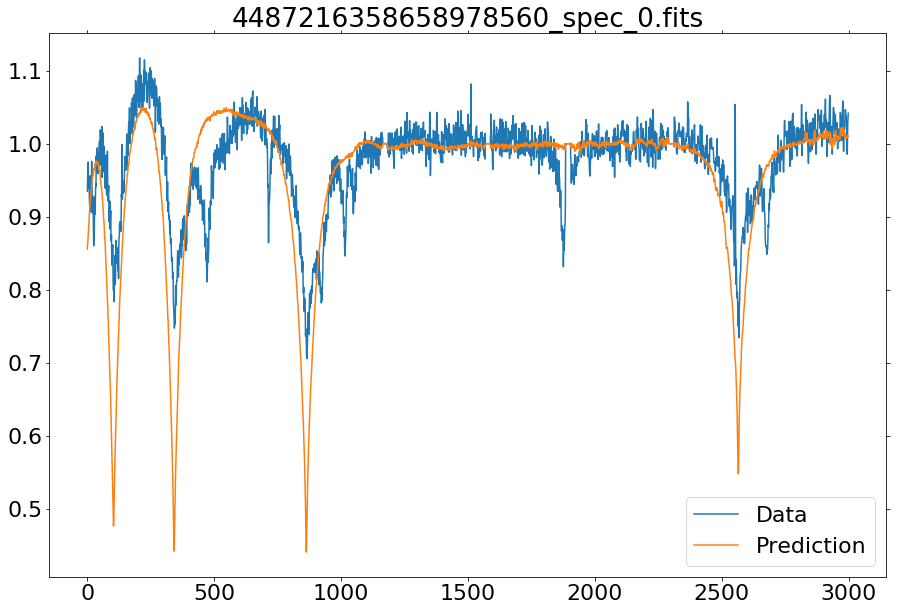

3302526729012505472_spec_0.fits


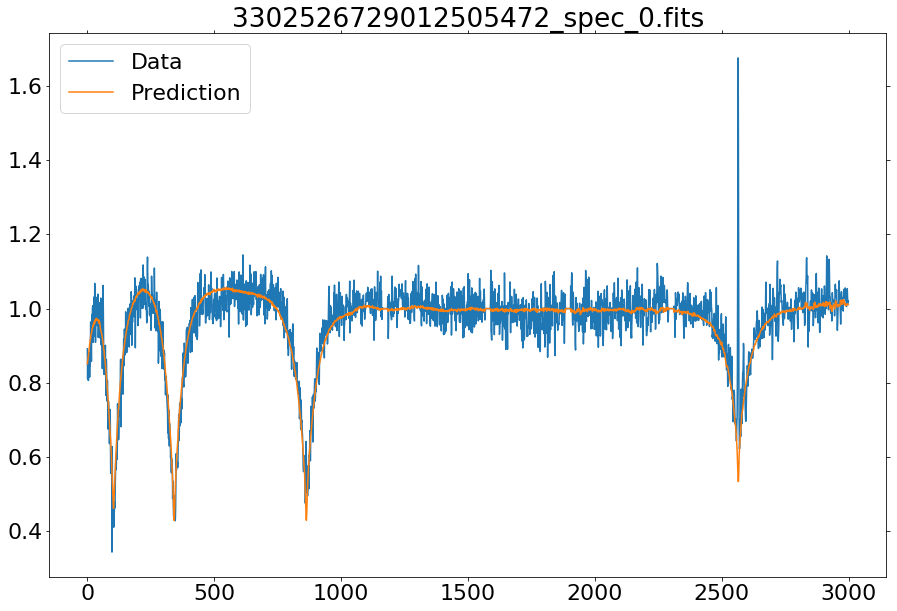

1243679832928795136_spec_0.fits


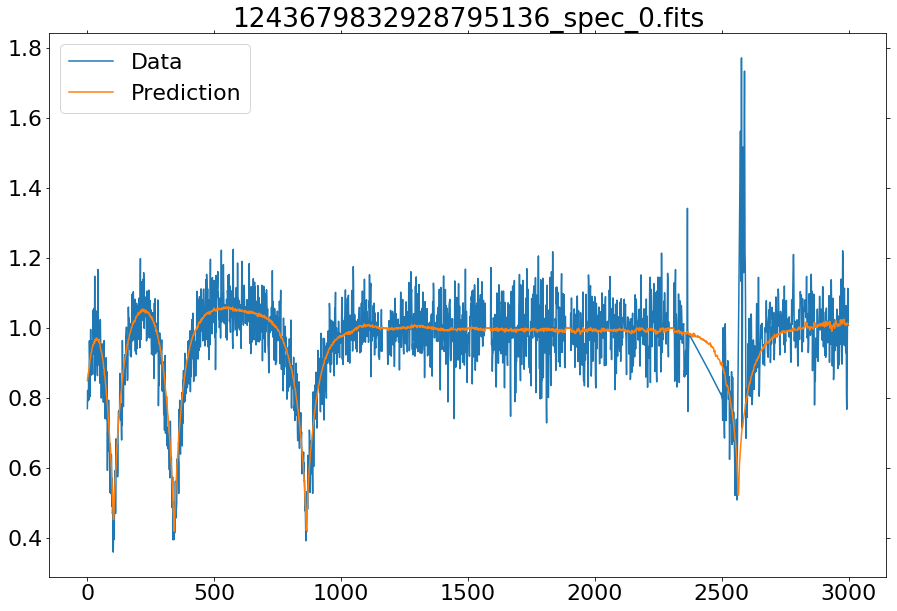

2542961560852591744_spec_0.fits


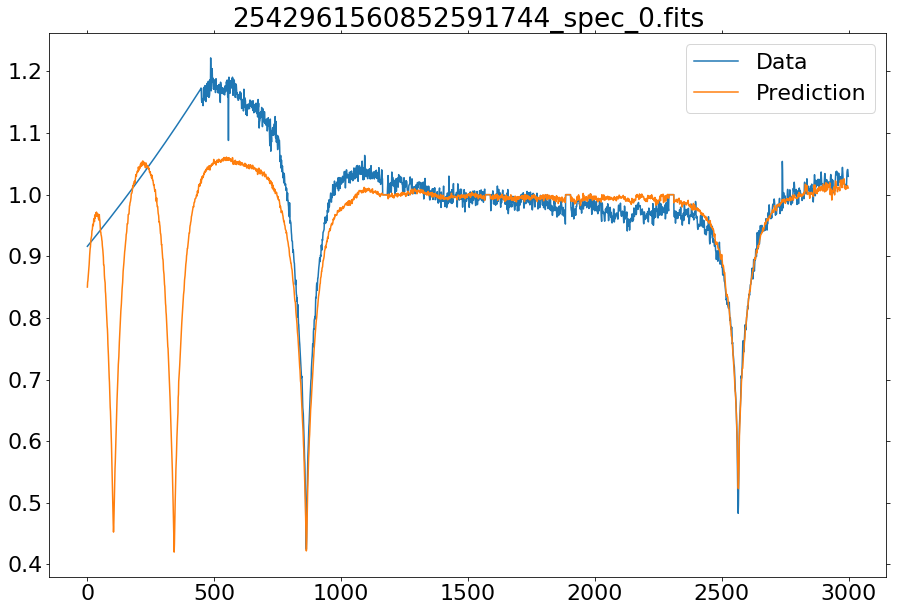

3806602267172416000_spec_0.fits


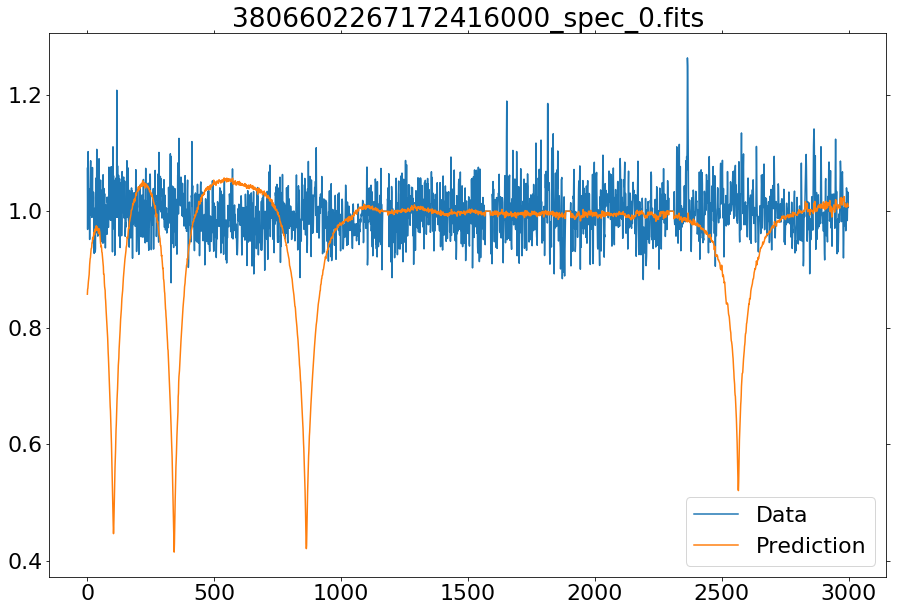

4463904719284925440_spec_0.fits


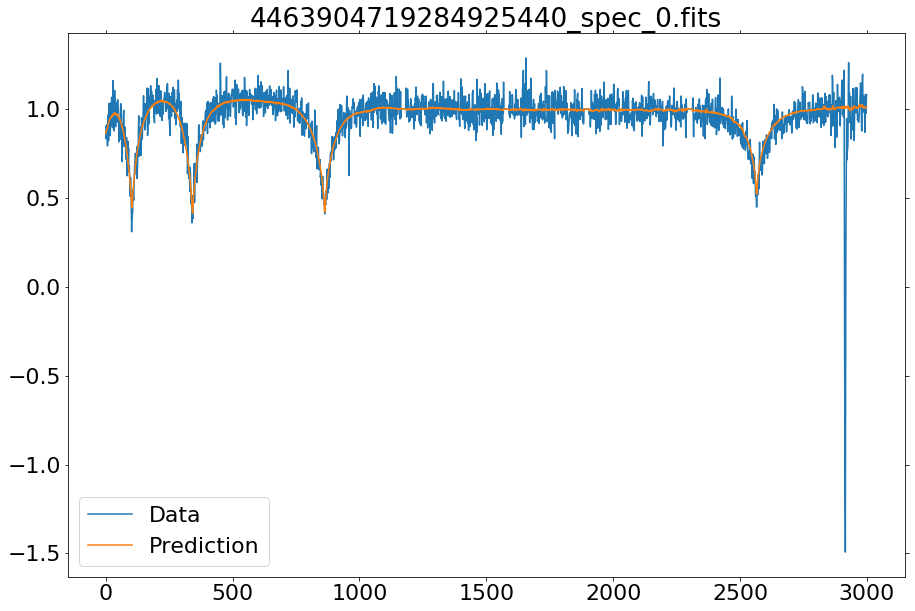

3681955719172822400_spec_0.fits


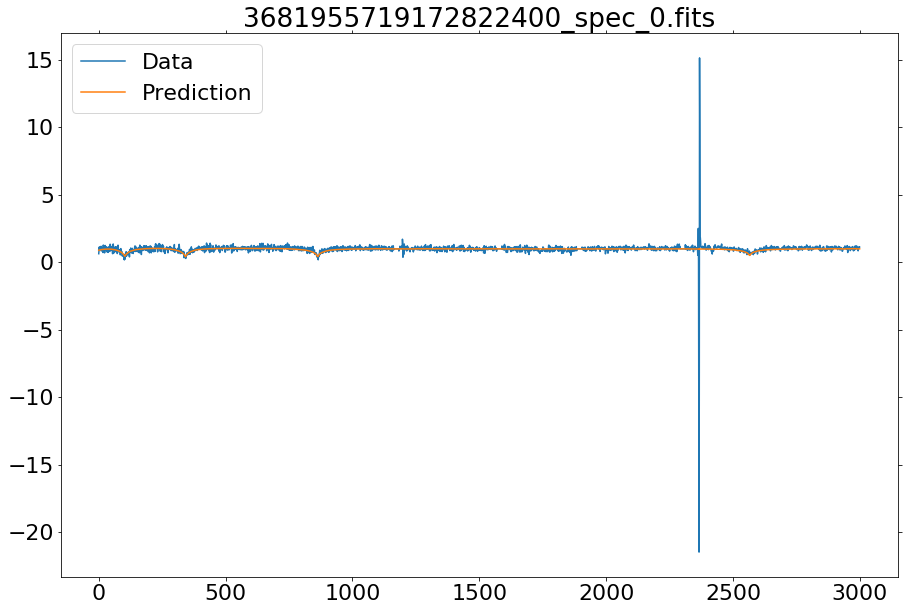

721244821406496640_spec_0.fits


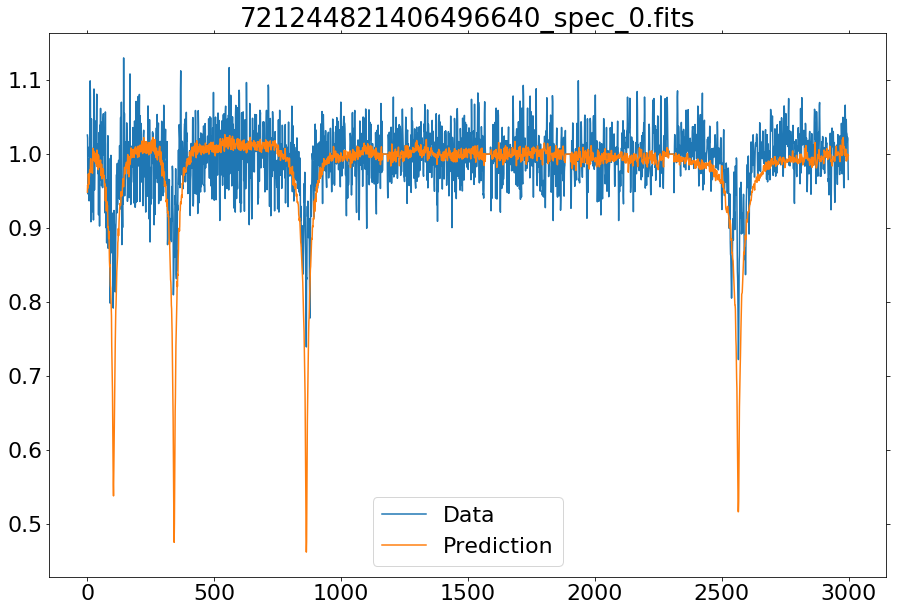

1523116177642231808_spec_0.fits


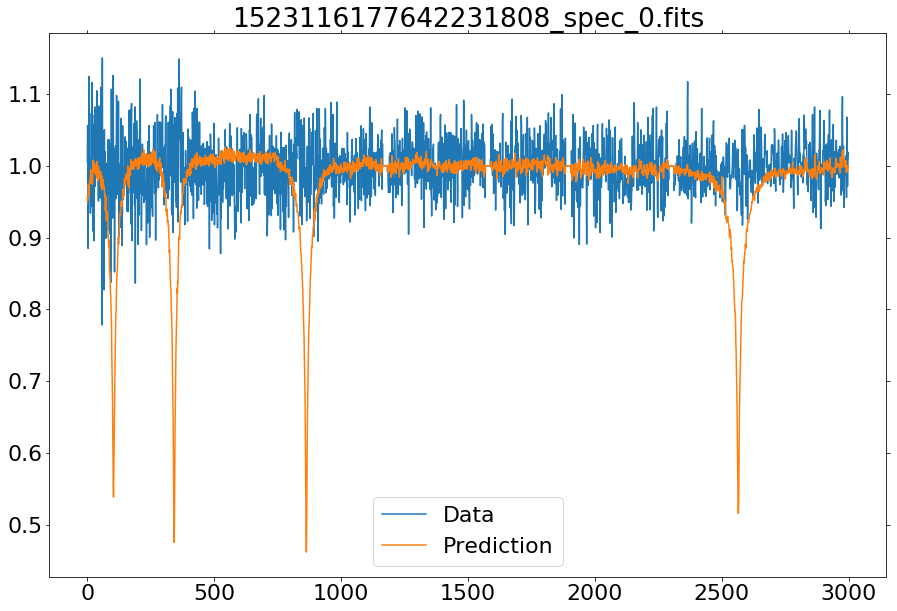

In [74]:
for i in range(sum(outliers)):
    plt.figure(figsize=(15,10))
    plt.plot(outspec[i],label='Data')
    #plt.title('BP-RP = %.2f, ABS-G = %0.2f'%(outlabel[i][0],outlabel[i][1]))
    plt.title(outnames[i])
    plt.plot(outpred[i],label='Prediction')
    plt.legend()
    print(outnames[i])
    plt.show()

# PRF